In [45]:
import types
import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt 
import matplotlib.cm as cm
import plotly as py
import plotly.graph_objs as go
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import warnings
import os



# se erros com importação execute no prompt $ pip install <Nome da importação>

In [32]:

path = r'/home/alefe/Workspace/Data-Mining/Imports/Data/bess-bms_0.csv'
data = pd.read_csv(path,sep=';')

# Colunas da string 1
Bstring_1 = ['Bstring1_Battery_Voltage', 'Bstring1_Battery_Current', 'Bstring1_Battery_Soc']

data = data[Bstring_1]

In [33]:
variables = ['Bstring1_Battery_Voltage', 'Bstring1_Battery_Soc']

X2 = data[variables].iloc[: , :].values
inertia = []
for n in range(1 , 11):
    algorithm = (KMeans(n_clusters = n))
    algorithm.fit(X2)
    inertia.append(algorithm.inertia_)

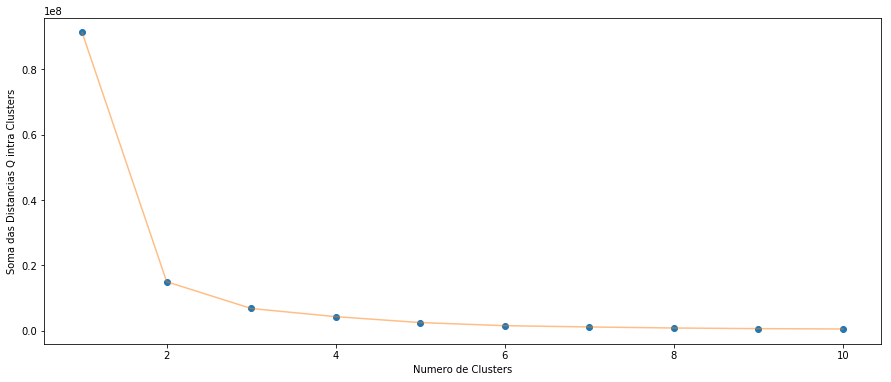

In [34]:
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , 11) , inertia , 'o')
plt.plot(np.arange(1 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Numero de Clusters') , plt.ylabel('Soma das Distancias Q intra Clusters')
plt.show()

In [35]:
# indique a quantidade de clusters desejada
clusters_number=2

algorithm = (KMeans(n_clusters =clusters_number ))
algorithm.fit(X1)

# Saída:

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=24000,
       n_clusters=clusters_number, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=24000,
    n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

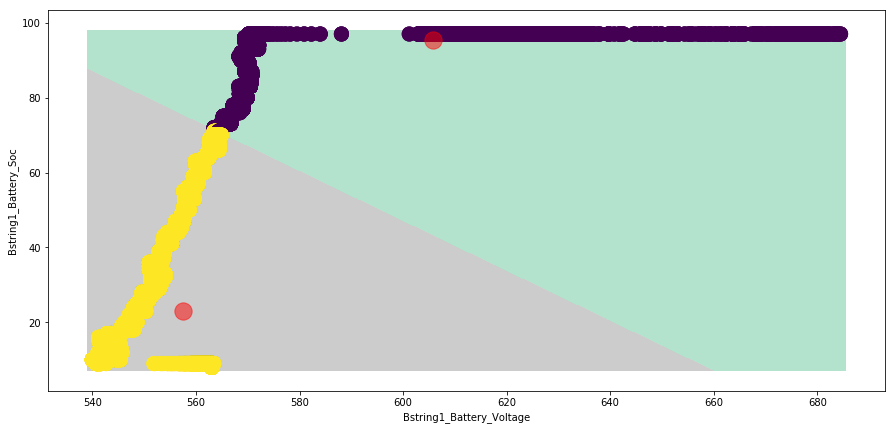

In [36]:
labels2 = algorithm.labels_
centroids2 = algorithm.cluster_centers_

h = 0.02
x_min, x_max = X2[:, 0].min() - 1, X2[:, 0].max() + 1
y_min, y_max = X2[:, 1].min() - 1, X2[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = algorithm.predict(np.c_[xx.ravel(), yy.ravel()]) 

plt.figure(1 , figsize = (15 , 7) )
plt.clf()
Z2 = Z.reshape(xx.shape)
plt.imshow(Z2 , interpolation='nearest', extent=(xx.min(), xx.max(), yy.min(), yy.max()), cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')
plt.scatter( x = variables[0] ,y = variables[1] , data = data , c = labels2 , s = 200 )
plt.scatter(x = centroids2[: , 0] , y =  centroids2[: , 1] , s = 300 , c = 'red' , alpha = 0.5)
plt.ylabel(variables[1]) , plt.xlabel(variables[0])
plt.show()

In [44]:
data['clusters'] = algorithm.labels_
columns = variables + ['clusters']
df_group = data[columns].groupby("clusters")
df_group.describe()

Bstring1_Battery_Voltage                                              \
                            count        mean        std    min    25%    50%   
clusters                                                                        
0                         26293.0  605.697055  17.131700  563.5  605.1  607.2   
1                         16377.0  557.485731   6.914544  540.0  552.2  561.0   

                       Bstring1_Battery_Soc                                    \
            75%    max                count       mean        std   min   25%   
clusters                                                                        
0         609.7  684.5              26293.0  95.470962   4.970838  71.0  97.0   
1         563.1  564.9              16377.0  23.116077  18.889366   8.0   9.0   

                            
           50%   75%   max  
clusters                    
0         97.0  97.0  97.0  
1         11.0  35.0  71.0

('For n_clusters =', 2, 'The average silhouette_score is :', 0.7780078887812886)
('For n_clusters =', 3, 'The average silhouette_score is :', 0.7800674804016545)
('For n_clusters =', 4, 'The average silhouette_score is :', 0.7966763906875466)


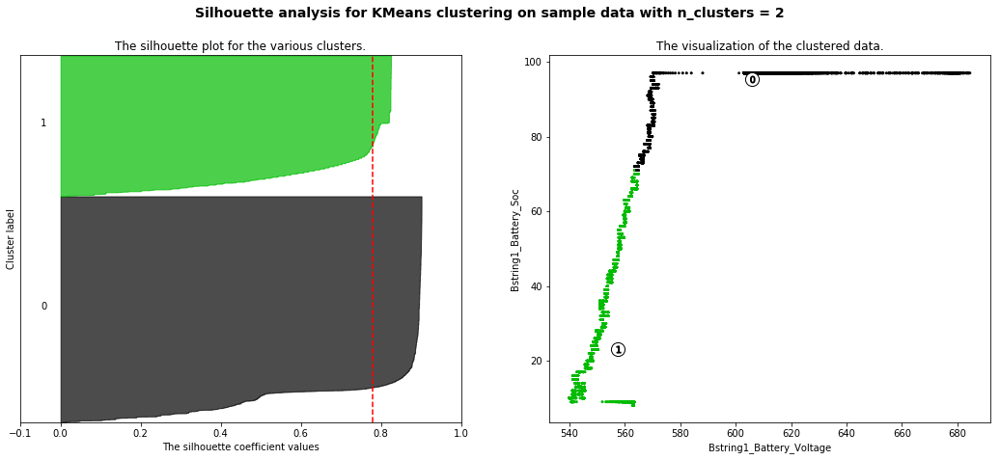

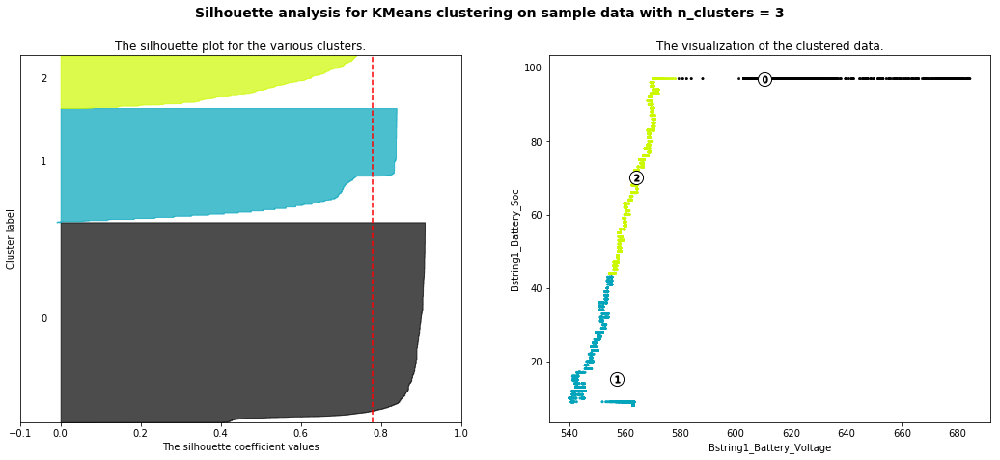

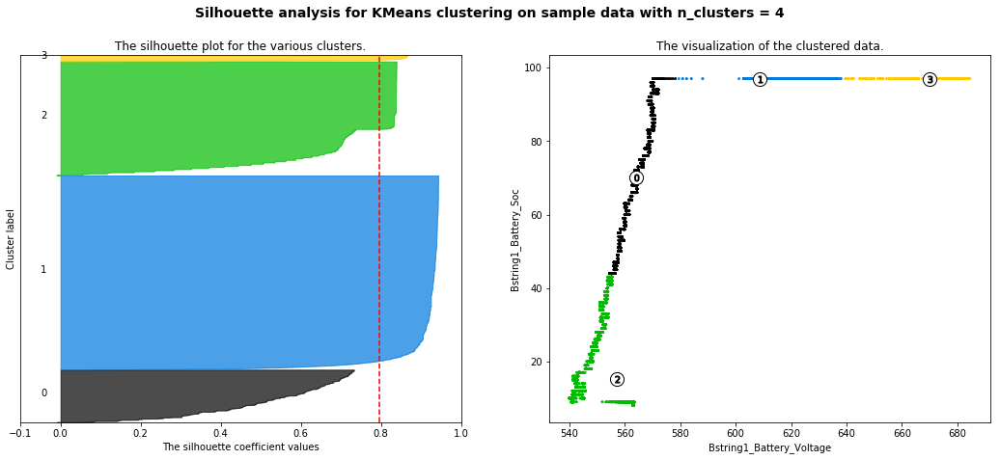

In [49]:

range_n_clusters = [2, 3, 4]

for n_clusters in range_n_clusters:
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(X1) + (n_clusters + 1) * 10])
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X1)
    silhouette_avg = silhouette_score(X1, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)
    sample_silhouette_values = silhouette_samples(X1, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10 

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([]) 
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X1[:, 0], X1[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    centers = clusterer.cluster_centers_
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel(variables[0])
    ax2.set_ylabel(variables[1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()